<a href="https://colab.research.google.com/github/AleOi2/PSI3472/blob/master/Aula8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exercício 1

In [ ]:
#membrane_unet.py - testado em colab em TF2
import cv2;
import numpy as np; np.random.seed(7);
import os;
import sys;
import tensorflow.keras as keras
import keras.backend as K;
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.preprocessing.image import ImageDataGenerator
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def unet(input_size = (128,128,1)):
  inputs = Input(input_size) #128x128
  conv2 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(inputs)
  conv2 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(conv2)
  pool2 = MaxPooling2D(pool_size=(2, 2))(conv2) #64x64
  conv3 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(pool2)
  conv3 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(conv3)
  pool3 = MaxPooling2D(pool_size=(2, 2))(conv3) #32x32
  conv4 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(pool3)
  conv4 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(conv4)
  drop4 = Dropout(0.5)(conv4) #32x32
  pool4 = MaxPooling2D(pool_size=(2, 2))(drop4) #16x16
  conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same' )(pool4)
  conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same' )(conv5)
  drop5 = Dropout(0.5)(conv5) #16x16
  up6 = Conv2D(256, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(drop5)) #32x32
  merge6 = concatenate([drop4,up6], axis = 3)#32x32
  conv6 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(merge6)
  conv6 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(conv6)
  up7 = Conv2D(128, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(conv6)) #64x64
  merge7 = concatenate([conv3,up7], axis = 3)
  conv7 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(merge7)
  conv7 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(conv7)
  up8 = Conv2D(164, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(conv7)) #128x128
  merge8 = concatenate([conv2,up8], axis = 3)
  conv8 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(merge8)
  conv8 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(conv8)
  conv8 = Conv2D(2, 3, activation = 'relu', padding = 'same' )(conv8)
  conv9 = Conv2D(1, 1, activation = 'sigmoid', padding = 'same' ,
  bias_initializer=keras.initializers.Constant(value=1.5))(conv8)
  model = Model(inputs = inputs, outputs = conv9)
  model.compile(optimizer = Adam(lr = 1e-3),
  loss = 'mean_squared_error', metrics = ['accuracy'])
  model.summary()
  return model
#<<<<<<<<<<<<<<<< main <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<
nomeprog="membrane_unet"
train_path='/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/haebase/membrane/train';
#outDir = "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/haebase/membrane_out"; os.chdir(outDir)
outDir =  "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/haebase/membrane_out"; os.chdir(outDir) 

aug_dict = dict(rotation_range=10, #Int. Degree range for random rotations.
width_shift_range=0.05, #float: fraction of total width, if < 1, or pixels if >= 1.
height_shift_range=0.05, #float: fraction of total height, if < 1, or pixels if >= 1.
shear_range=10, #Float. Shear Intensity (Shear angle in counter-clockwise direction in degrees)
zoom_range=0.2, #Range for random zoom. If a float, [lower, upper] = [1-zoom_range, 1+zoom_range].
horizontal_flip=False, #Boolean. Randomly flip inputs horizontally.
fill_mode='reflect'); #One of {"constant", "nearest", "reflect" or "wrap"}.
image_folder='image';
mask_folder= 'label';
target_size = (128,128);
batch_size=10;
seed = 7;
save_to_dir = None;
image_datagen = ImageDataGenerator(**aug_dict);
mask_datagen = ImageDataGenerator(**aug_dict);
image_generator = image_datagen.flow_from_directory(
 train_path,
 classes = [image_folder],
 class_mode = None,
 color_mode = "grayscale",
 target_size = target_size,
 batch_size = batch_size,
 seed = seed);
mask_generator = mask_datagen.flow_from_directory(
 train_path,
 classes = [mask_folder],
 class_mode = None,
 color_mode = "grayscale",
 target_size = target_size,
 batch_size = batch_size,
 seed = seed);
def trainGenerator():
  train_generator=zip(image_generator,mask_generator)
  for (img,mask) in train_generator:
    img=img/255
    mask=mask/255
    mask[mask > 0.5] = 1
    mask[mask <= 0.5] = 0
    yield(img,mask)
#<<<<<<<<<<<<<<<<< main <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<
#Escolha entre comecar treino do zero ou continuar o treino de onde parou
model = unet();
#model = load_model(nomeprog+".h5");
model.fit(trainGenerator(),steps_per_epoch=30,epochs=20,verbose=1);
model.save(nomeprog+".h5");

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Found 30 images belonging to 1 classes.
Found 30 images belonging to 1 classes.
Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d_38 (Conv2D)              (None, 128, 128, 64) 640         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_39 (Conv2D)              (None, 128, 128, 64) 36928       conv2d_38[0][0]                  
____________________________________________________________________________

In [ ]:
#membrane_unet.py - testado em colab em TF2
import cv2;
import numpy as np; np.random.seed(7);
import os;
import sys;
import tensorflow.keras as keras
import keras.backend as K;
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.preprocessing.image import ImageDataGenerator
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
from google.colab import drive
drive.mount('/content/drive')

def unet(input_size = (128,128,1)):
  inputs = Input(input_size) #128x128
  conv2 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(inputs)
  conv2 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(conv2)
  conv2 = BatchNormalization()(conv2)
  pool2 = MaxPooling2D(pool_size=(2, 2))(conv2) #64x64
  conv3 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(pool2)
  conv3 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(conv3)
  conv3 = BatchNormalization()(conv3)
  pool3 = MaxPooling2D(pool_size=(2, 2))(conv3) #32x32
  conv4 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(pool3)
  conv4 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(conv4)
  conv4 = BatchNormalization()(conv4)
  drop4 = Dropout(0.5)(conv4) #32x32
  pool4 = MaxPooling2D(pool_size=(2, 2))(drop4) #16x16
  conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same' )(pool4)
  conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same' )(conv5)
  conv5 = BatchNormalization()(conv5)
  drop5 = Dropout(0.5)(conv5) #16x16
  up6 = Conv2D(256, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(drop5)) #32x32
  merge6 = concatenate([drop4,up6], axis = 3)#32x32
  conv6 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(merge6)
  conv6 = Conv2D(256, 3, activation = 'relu', padding = 'same' )(conv6)
  up7 = Conv2D(128, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(conv6)) #64x64
  merge7 = concatenate([conv3,up7], axis = 3)
  conv7 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(merge7)
  conv7 = Conv2D(128, 3, activation = 'relu', padding = 'same' )(conv7)
  up8 = Conv2D(164, 2, activation = 'relu', padding = 'same'
  )(UpSampling2D(size = (2,2))(conv7)) #128x128
  merge8 = concatenate([conv2,up8], axis = 3)
  conv8 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(merge8)
  conv8 = Conv2D(64, 3, activation = 'relu', padding = 'same' )(conv8)
  conv8 = Conv2D(2, 3, activation = 'relu', padding = 'same' )(conv8)
  conv9 = Conv2D(1, 1, activation = 'sigmoid', padding = 'same' ,
  bias_initializer=keras.initializers.Constant(value=1.5))(conv8)
  model = Model(inputs = inputs, outputs = conv9)
  model.compile(optimizer = Adam(lr = 1e-3),
  loss = 'mean_squared_error', metrics = ['accuracy'])
  model.summary()
  return model
#<<<<<<<<<<<<<<<< main <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<
nomeprog="membrane_unet"
train_path='/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/haebase/membrane/train';
outDir = "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/haebase/membrane_out"; os.chdir(outDir)
aug_dict = dict(rotation_range=10, #Int. Degree range for random rotations.
width_shift_range=0.05, #float: fraction of total width, if < 1, or pixels if >= 1.
height_shift_range=0.05, #float: fraction of total height, if < 1, or pixels if >= 1.
shear_range=10, #Float. Shear Intensity (Shear angle in counter-clockwise direction in degrees)
zoom_range=0.2, #Range for random zoom. If a float, [lower, upper] = [1-zoom_range, 1+zoom_range].
horizontal_flip=False, #Boolean. Randomly flip inputs horizontally.
fill_mode='reflect'); #One of {"constant", "nearest", "reflect" or "wrap"}.
image_folder='image';
mask_folder= 'label';
target_size = (128,128);
batch_size=10;
seed = 7;
save_to_dir = None;
image_datagen = ImageDataGenerator(**aug_dict);
mask_datagen = ImageDataGenerator(**aug_dict);
image_generator = image_datagen.flow_from_directory(
 train_path,
 classes = [image_folder],
 class_mode = None,
 color_mode = "grayscale",
 target_size = target_size,
 batch_size = batch_size,
 seed = seed);
mask_generator = mask_datagen.flow_from_directory(
 train_path,
 classes = [mask_folder],
 class_mode = None,
 color_mode = "grayscale",
 target_size = target_size,
 batch_size = batch_size,
 seed = seed);
def trainGenerator():
  train_generator=zip(image_generator,mask_generator)
  for (img,mask) in train_generator:
    img=img/255
    mask=mask/255
    mask[mask > 0.5] = 1
    mask[mask <= 0.5] = 0
    yield(img,mask)
#<<<<<<<<<<<<<<<<< main <<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<
#Escolha entre comecar treino do zero ou continuar o treino de onde parou
model = unet();
#model = load_model(nomeprog+".h5");
model.fit(trainGenerator(),steps_per_epoch=30,epochs=20,verbose=2);
model.save(nomeprog+".h5");

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Found 30 images belonging to 1 classes.
Found 30 images belonging to 1 classes.
Model: "functional_111"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_22 (InputLayer)           [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
conv2d_76 (Conv2D)              (None, 128, 128, 64) 640         input_22[0][0]                   
__________________________________________________________________________________________________
conv2d_77 (Conv2D)              (None, 128, 128, 64) 36928       conv2d_76[0][0]                  
__________________________________________________________________________

# Exercício 2

In [ ]:
def ShowImage(height, width,out,image):
  from matplotlib import pyplot as plt
  f = plt.figure()
  f.set_figheight(height)
  f.set_figwidth(width)
  f.add_subplot(1,2,1)
  plt.imshow(out)
  plt.axis('off')
  f.add_subplot(1,2,2)
  plt.imshow(image)
  plt.axis('off')


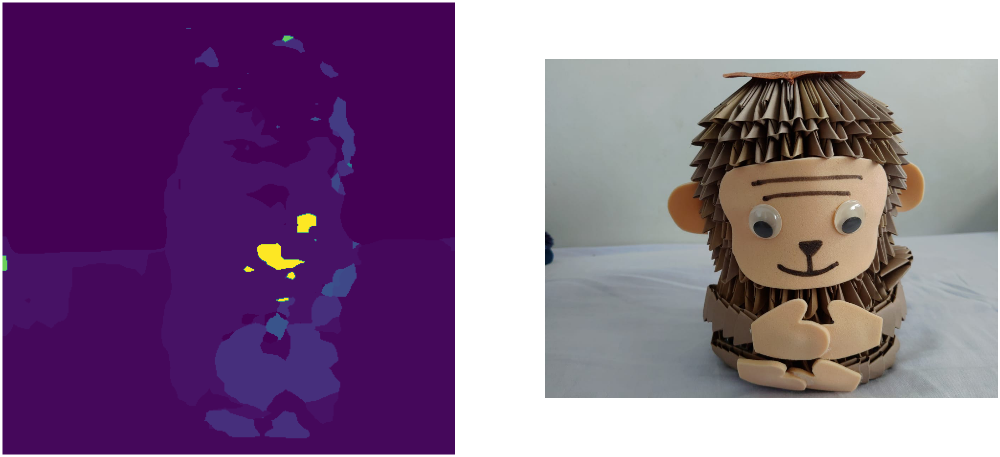

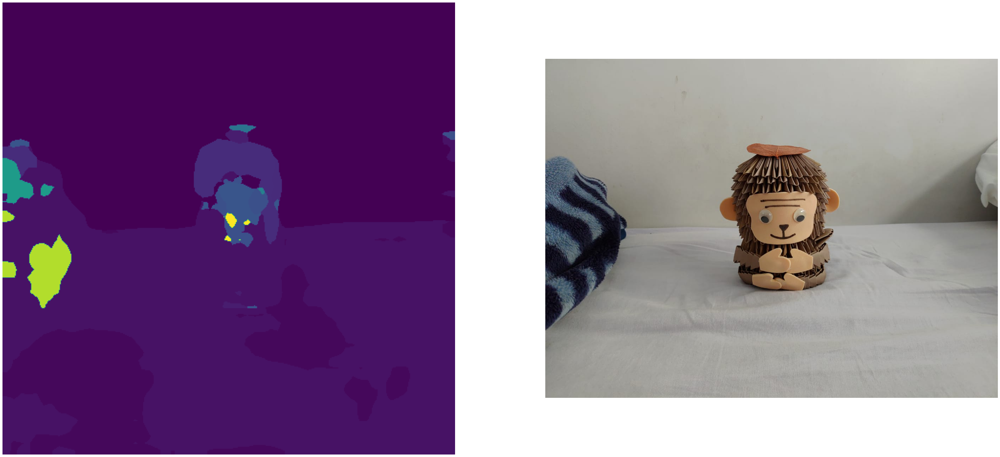

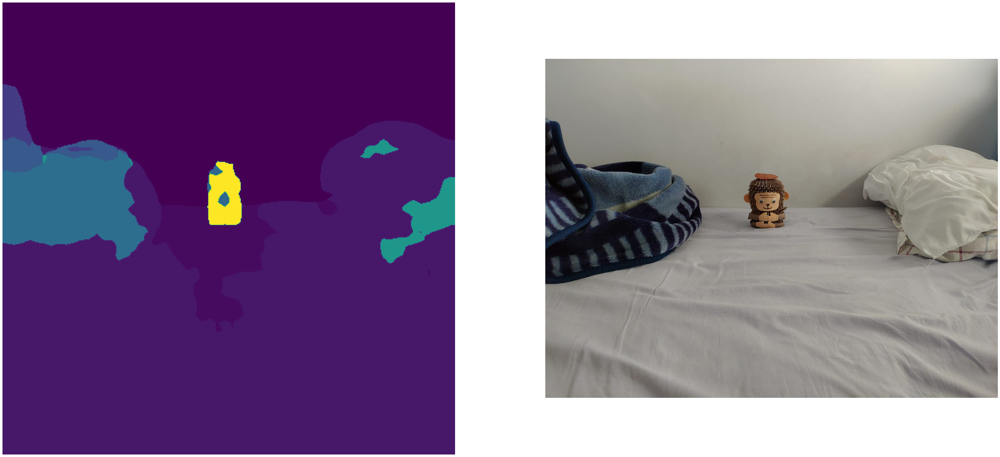

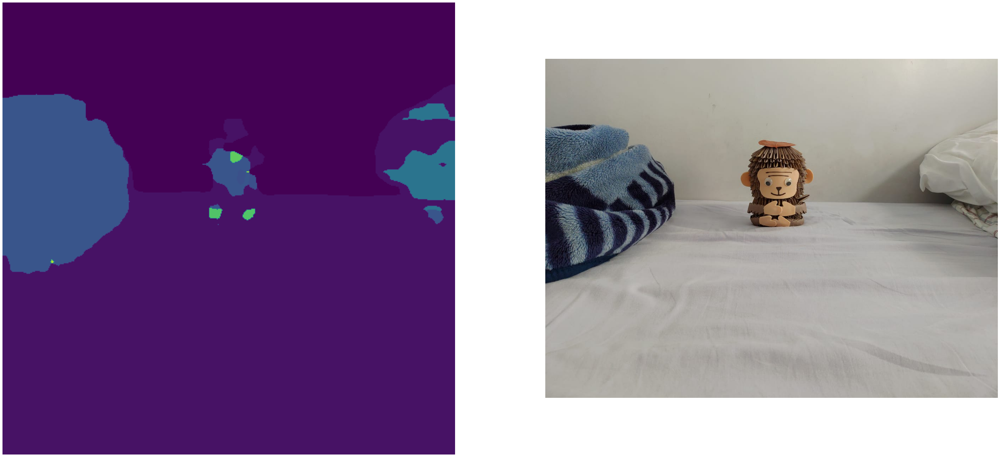

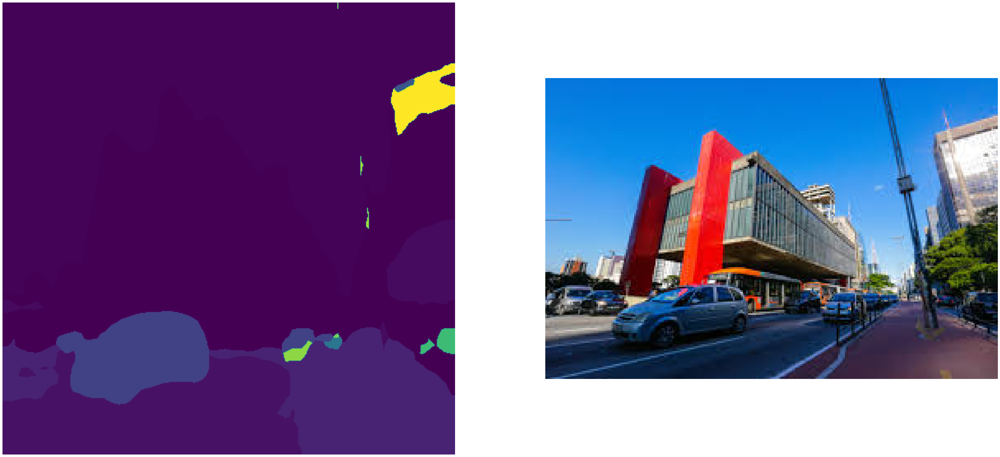

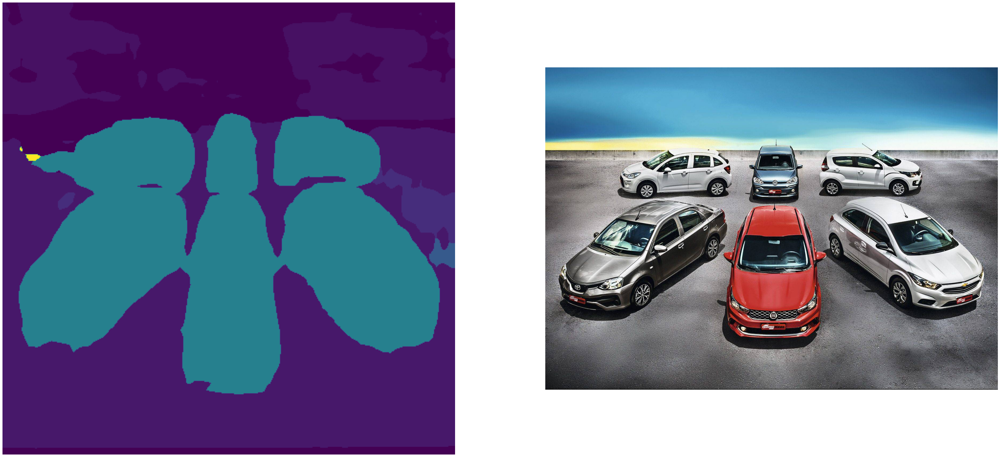

In [ ]:
#pretrained.py - testado em Colab para TF2
!pip3 install keras-segmentation
from PIL import Image
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
from keras_segmentation.pretrained import pspnet_50_ADE_20K , pspnet_101_cityscapes, pspnet_101_voc12
outDir = "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/segment"; os.chdir(outDir)
#load any of the 3 pretrained models
model = pspnet_50_ADE_20K() # load the pretrained model trained on ADE20k dataset
# model = pspnet_101_cityscapes() # load the pretrained model trained on Cityscapes dataset
# model = pspnet_101_voc12() # load the pretrained model trained on Pascal VOC 2012 dataset

out = model.predict_segmentation(
 inp="fig1.jpeg",
 out_fname="fig1_out_50_ADE_20K.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("fig1.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig2.jpeg",
 out_fname="fig2_out_50_ADE_20K.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("fig2.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig3.jpeg",
 out_fname="fig3_out_50_ADE_20K.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("fig3.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig4.jpeg",
 out_fname="fig4_out_50_ADE_20K.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("fig4.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="SP.jpeg",
 out_fname="SP_out_50_ADE_20K.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("SP.jpeg").convert('RGB'))


out = model.predict_segmentation(
 inp="car.jpg",
 out_fname="car_out_50_ADE_20K.jpg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("car.jpg").convert('RGB'))


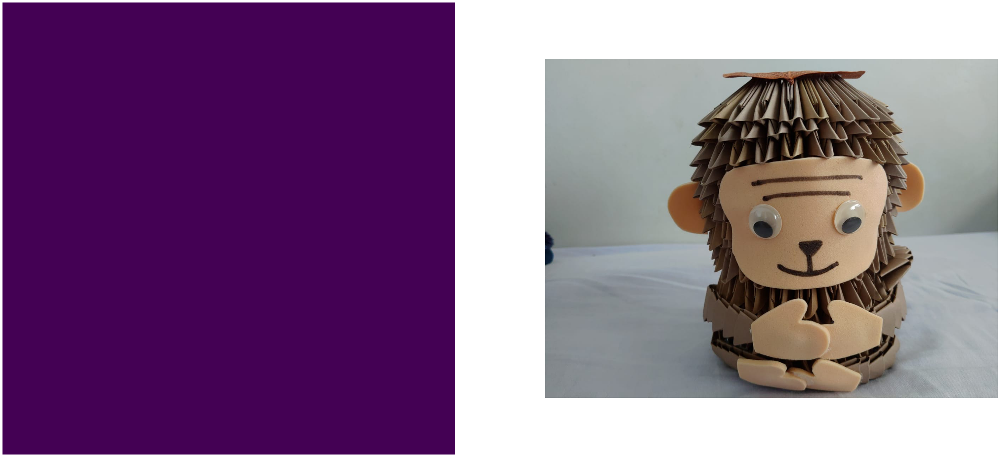

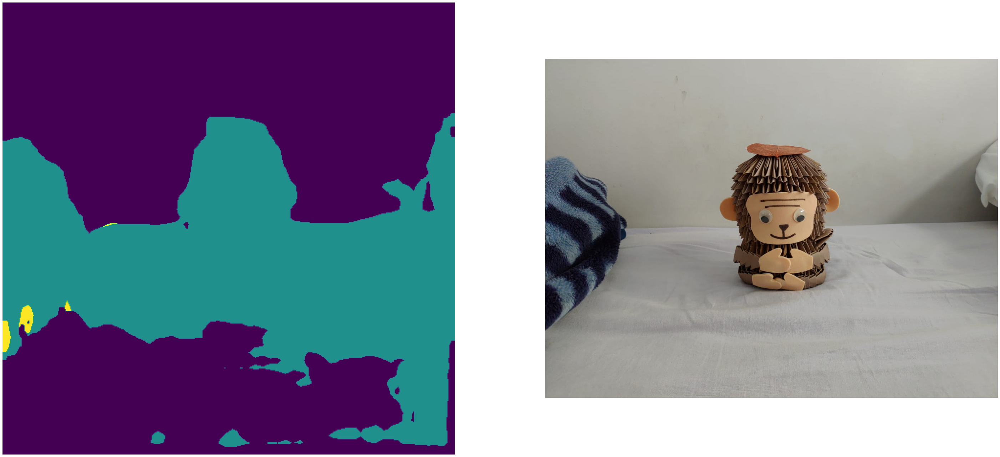

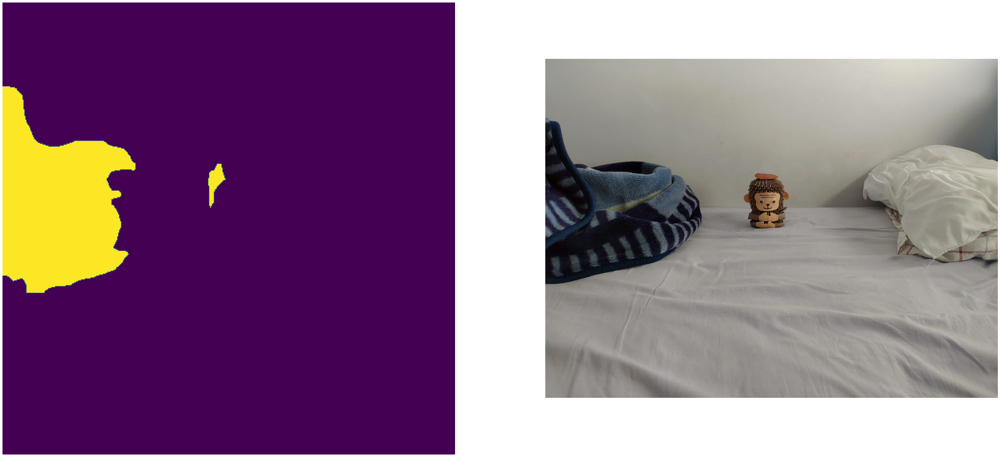

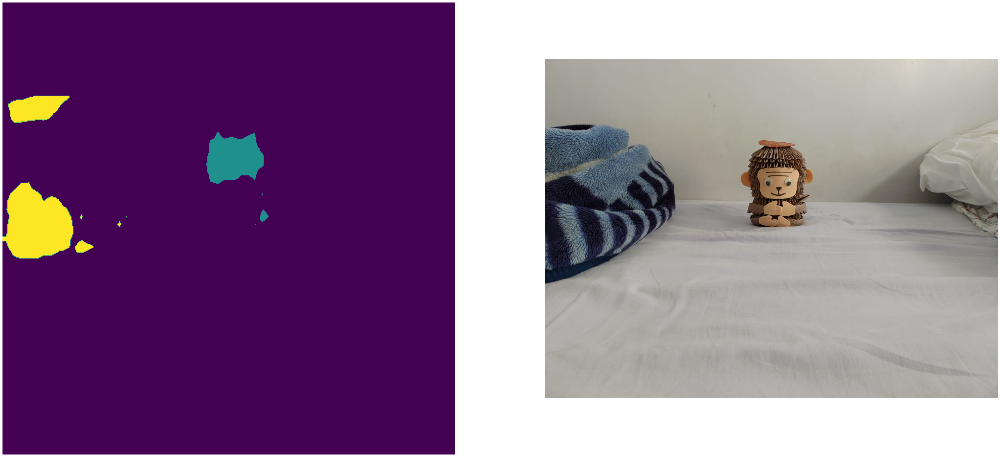

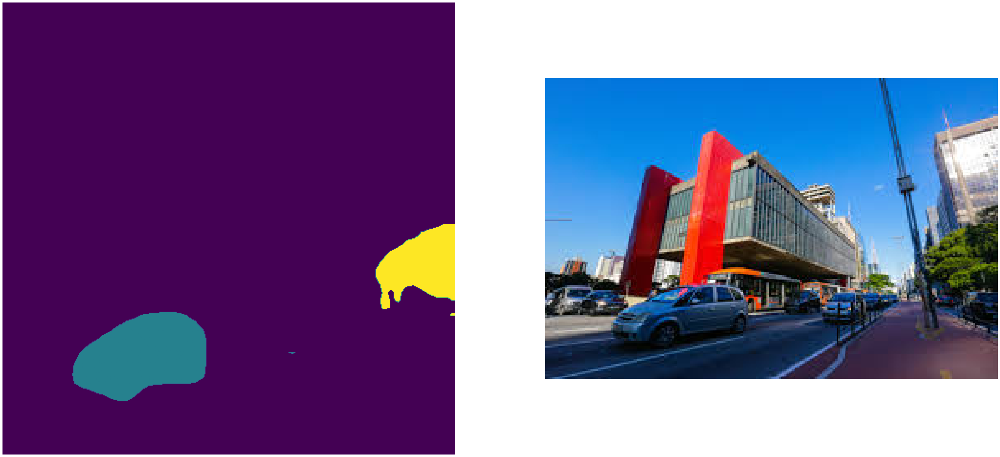

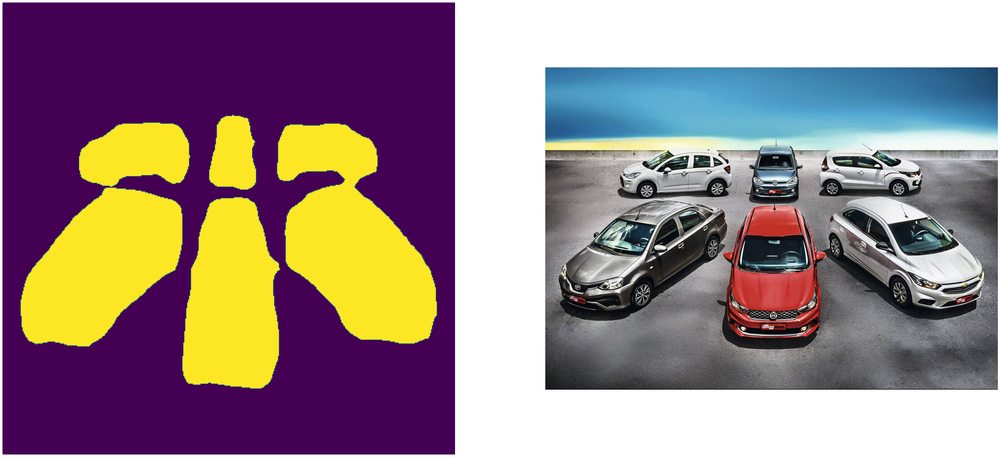

In [ ]:
#pretrained.py - testado em Colab para TF2
!pip3 install keras-segmentation
from PIL import Image  
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
from keras_segmentation.pretrained import pspnet_50_ADE_20K , pspnet_101_cityscapes, pspnet_101_voc12
outDir = "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/segment"; os.chdir(outDir)
#load any of the 3 pretrained models
# model = pspnet_50_ADE_20K() # load the pretrained model trained on ADE20k dataset
model = pspnet_101_cityscapes() # load the pretrained model trained on Cityscapes dataset
model = pspnet_101_voc12() # load the pretrained model trained on Pascal VOC 2012 dataset
out = model.predict_segmentation(
 inp="fig1.jpeg",
 out_fname="fig1_out_101_cityscapes.jpeg"
)

ShowImage(50,50,out, Image.open("fig1.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig2.jpeg",
 out_fname="fig2_out_101_cityscapes.jpeg"
)
ShowImage(50,50,out, Image.open("fig2.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig3.jpeg",
 out_fname="fig3_out_101_cityscapes.jpeg"
)
ShowImage(50,50,out, Image.open("fig3.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig4.jpeg",
 out_fname="fig4_out_101_cityscapes.jpeg"
)
ShowImage(50,50,out, Image.open("fig4.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="SP.jpeg",
 out_fname="SP_out_101_cityscapes.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("SP.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="car.jpg",
 out_fname="car_out_101_cityscapes.jpg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("car.jpg").convert('RGB'))


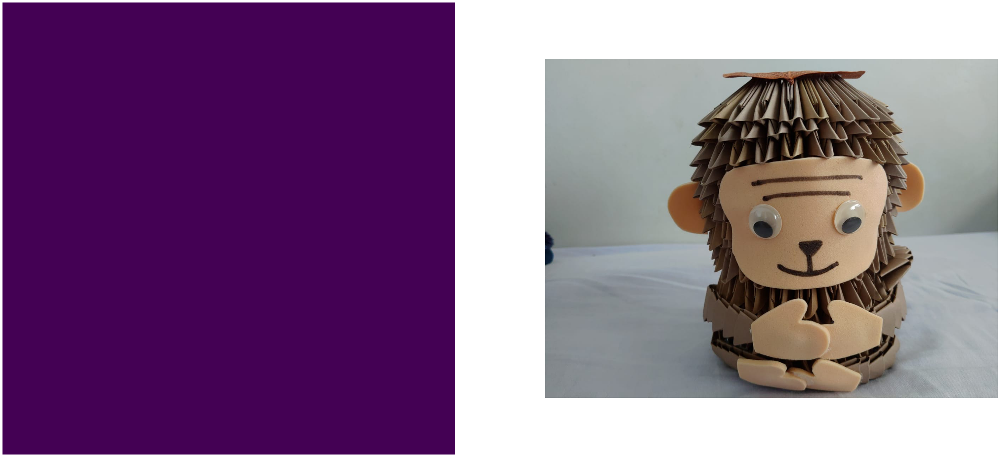

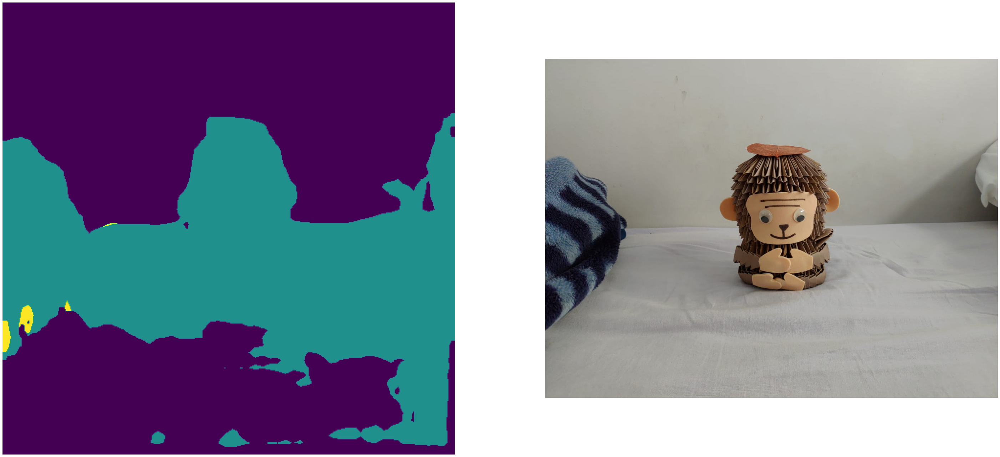

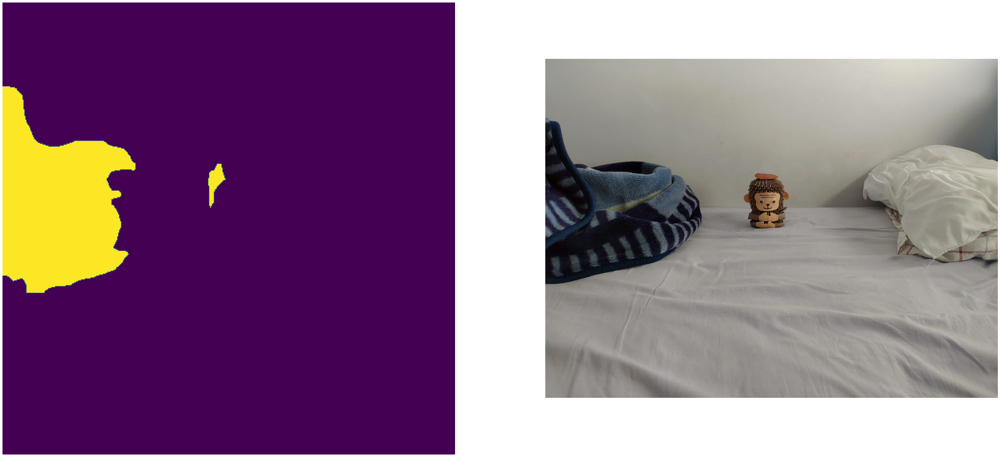

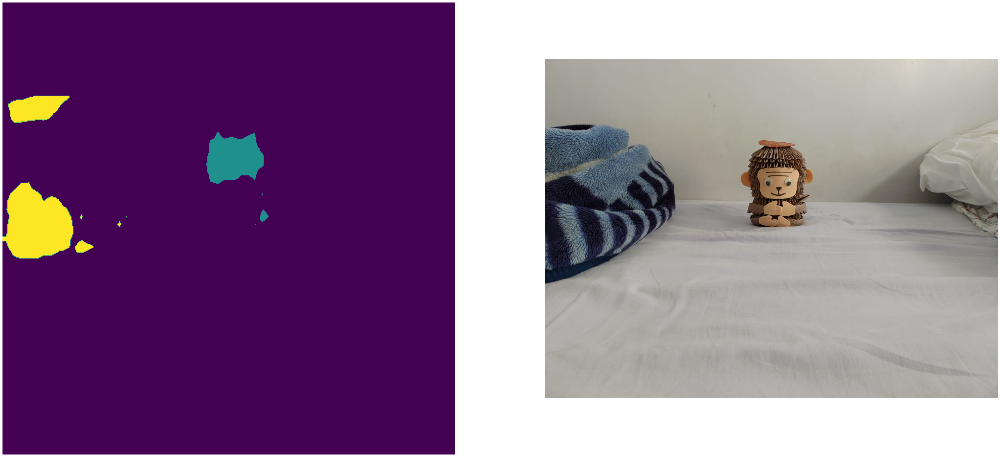

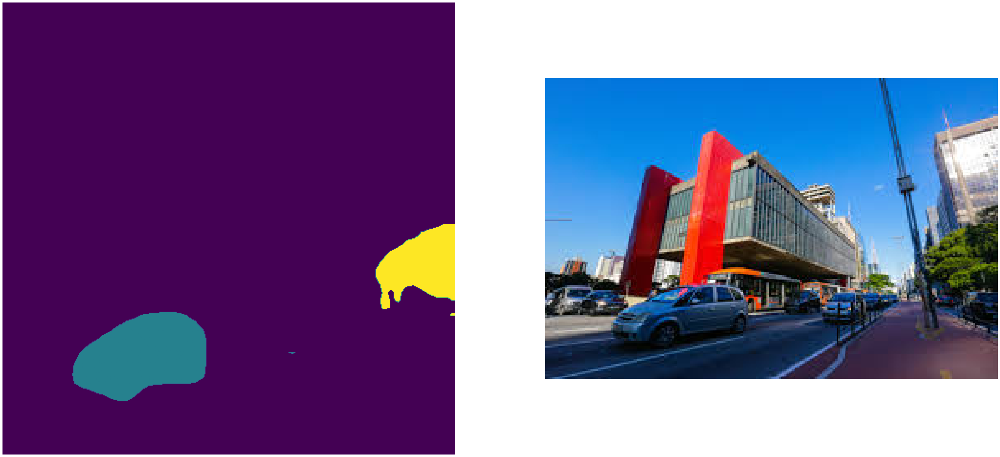

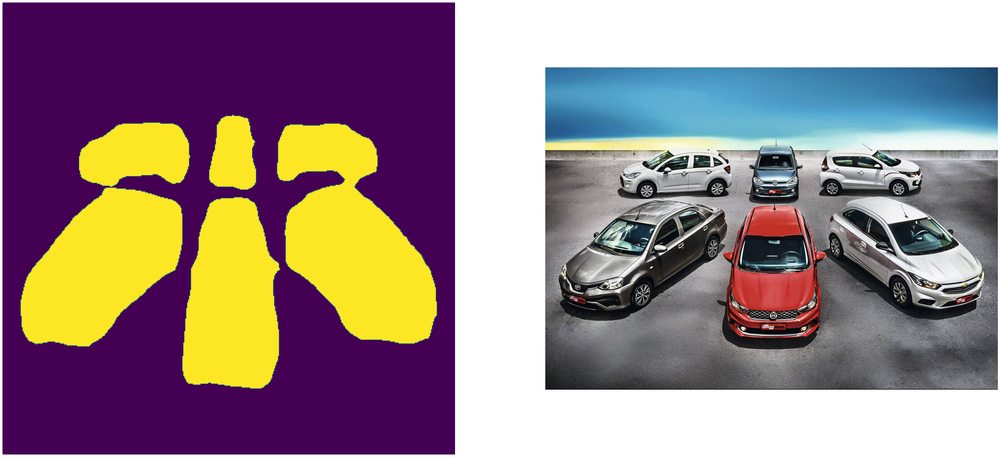

In [ ]:
#pretrained.py - testado em Colab para TF2
!pip3 install keras-segmentation
import os; os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
from keras_segmentation.pretrained import pspnet_50_ADE_20K , pspnet_101_cityscapes, pspnet_101_voc12
outDir = "/content/drive/My Drive/Colab Notebooks/psi3472/Aula8/segment"; os.chdir(outDir)
#load any of the 3 pretrained models
# model = pspnet_50_ADE_20K() # load the pretrained model trained on ADE20k dataset
# model = pspnet_101_cityscapes() # load the pretrained model trained on Cityscapes dataset
model = pspnet_101_voc12() # load the pretrained model trained on Pascal VOC 2012 dataset
out = model.predict_segmentation(
 inp="fig1.jpeg",
 out_fname="fig1_out_101_voc12.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("fig1.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig2.jpeg",
 out_fname="fig2_out_101_voc12.jpeg"
)
ShowImage(50,50,out, Image.open("fig2.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig3.jpeg",
 out_fname="fig3_out_101_voc12.jpeg"
)
ShowImage(50,50,out, Image.open("fig3.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="fig4.jpeg",
 out_fname="fig4_out_101_voc12.jpeg"
)
ShowImage(50,50,out, Image.open("fig4.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="SP.jpeg",
 out_fname="SP_out_101_voc12.jpeg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("SP.jpeg").convert('RGB'))

out = model.predict_segmentation(
 inp="car.jpg",
 out_fname="car_out_101_voc12.jpg"
)
#print( type(out), out.dtype, out.shape ) #out e' int64
ShowImage(50,50,out, Image.open("car.jpg").convert('RGB'))
